<img src="https://github.com/AmsterdamUMC/AmsterdamUMCdb/blob/master/img/logo_c4i_square.png?raw=1" alt="Logo C4I" width=128px/>

<img src="https://github.com/AmsterdamUMC/AmsterdamUMCdb/blob/master/img/logo_amds.png?raw=1" alt="Logo AMDS" width=128px/>

# AmsterdamUMCdb with Google BigQuery and Colaboratory
## AmsterdamUMCdb - Freely Accessible ICU Database

AmsterdamUMCdb version 1.0.2 March 2020  
Copyright &copy; 2003-2023 Amsterdam UMC - Amsterdam Medical Data Science

# Introduction
To encourage rapid data exploration and model development, access to AmsterdamUMCdb is also available using Google BigQuery with Google Colaboratory ('Colab') as the main coding environment. This removes the necessity of downloading the AmsterdamUMCdb csv files, setting up a database system and installing a coding environment.

This tutorial for using AmsterdamUMCdb on BigQuery was based on the original Google BigQuery tutorial on [Colab](https://colab.research.google.com/notebooks/bigquery.ipynb).

# Running Colab
If not done already, please open Colab with this **getting_started** notebook from the official AmsterdamUMCdb GitHub repository: [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/bigquery/getting_started.ipynb)

**Important**: when following this tutorial, make sure to follow *all* steps and to run the **code cells** using the **Play** button or by pressing `Ctrl-Enter`

# Before you Begin
Ensure you have a working Google account and verify that the e-mail address used when applying for access has been associated with this account. If you already have a Google account, you can add secondary e-mail addresses [here](https://myaccount.google.com/alternateemail), or alternatively create another Google account using the e-mail address used in the application form.

If you don't have any experience in using Jupyter notebooks and/or Python, it is recommended to familiarize yourself with the [basics](https://colab.research.google.com/notebooks/intro.ipynb).

# Accessing the database
Provided you have signed the end user license agreement, you will have free access to the data from AmsterdamUMCdb through the Google Cloud Platform.

To explore and query the database you need to create a Google Cloud Platform project. For new users, Google offers a free tier of 1 TB (2<sup>40</sup> bytes) per month for queries and in addition \$300 credit for free for use on the Google Cloud Platform (currently: \$6.00 per TB). In the unlikely event, this amount is not sufficient during a datathon or course, please contact us and we will work with you to find a solution.

# Signing up for Google Cloud Platform
- To sign up for the free tier and free credits, please visit the Google Cloud Platform: https://cloud.google.com/.
- Click **Get started for free**.
- Log in with the Google account you used when registering for the datathon.
- In Step 1 of 2: agree to the **Terms of Service** and select **Continue**. 
- In Step 2 of 2: You will be required to add some additional information, including a payment method to make sure you are not a robot. Don't worry you won't be charged unless you manually upgrade to a paid account. Depending on your payment provider, you may have an additional step to verify the payment method.
- Finally press **Start my free trial**. You are good to go.



<a name="cell-project-id"></a>
# Retrieving your Google Cloud Project ID
- At the top of the screen, select **My First Project** or [create a new one](https://console.cloud.google.com/projectcreate). Please write down the Project ID in the cell below ("Insert text here") and **Run** the cell to store the value.

In [1]:
# sets *your* project id
PROJECT_ID = "p48977-386620" #@param {type:"string"}

# Sets the default BigQuery dataset for accessing AmsterdamUMCdb

If you have received instructions to use a specific BigQuery instance, change the default settings here. Otherwise use these default values.

In [2]:
# sets default dataset for AmsterdamUMCdb 
DATASET_PROJECT_ID = 'amsterdamumcdb' #@param {type:"string"}
DATASET_ID = 'version1_0_2' #@param {type:"string"}
LOCATION = 'eu' #@param {type:"string"}

# Provide your credentials to access the AmsterdamUMCdb dataset on Google BigQuery
Authenticate your credentials with Google Cloud Platform and set your default Google Cloud Project ID as an environment variable for running query jobs. 

1. Run the cell. The `Allow this notebook to access your Google credentials?` prompt appears. Select `Allow`. 
2. In the `Sign in - Google Accounts` dialog, use the account you registered during the AmsterdamUMCdb application process and select `Allow` again.

In [4]:
import os
from google.colab import auth

# all libraries check this environment variable, so set it:
os.environ["GOOGLE_CLOUD_PROJECT"] = PROJECT_ID

auth.authenticate_user()
print('Authenticated')

Authenticated


# Google BigQuery costs
Since BiqQuery uses a [columnar data structure](https://en.wikipedia.org/wiki/Column-oriented_DBMS), Google will charge you according to the columns selected and the size of the data in those columns. Especially in the data exploration phase, it is prudent to query only the columns you will be actually needing for the analysis.

`SELECT * FROM numericitems` will process about 10 GiB data, where as

`SELECT admissionid, itemid, value, unitid, measuredat FROM numericitems` will process only 2.5 GiB.

**Important**: `LIMIT` or `WHERE` clauses do not have **any** effect on reducing the amount of data processed, and thus charged. These clauses will only limit the number of records returned by the query.

# Available documentation for AmsterdamUMCdb tables.
Additional information including sample Python code in Jupyter Notebooks and [SQL](https://github.com/AmsterdamUMC/AmsterdamUMCdb/tree/master/amsterdamumcdb/sql) is available from the official [AmsterdamUMCdb GitHub repository](https://github.com/AmsterdamUMC/AmsterdamUMCdb) and [wiki](https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki). 

Table | Wiki | Example code
:- | :--| -:
admissions|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/admissions | [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/admissions.ipynb) 
drugitems|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/drugitems|[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/drugitems.ipynb) 
freetextitems|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/freetextitems|[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/freetextitems.ipynb)
listitems|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/lisitems|[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/listitems.ipynb)
numericitems|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/numericitems|[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/numericitems.ipynb)
procedureorderitems|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/procedureorderitems|[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/procedureorderitems.ipynb)
processitems|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/processitems|[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/processitems.ipynb)


**Note**: In contrast to the downloadable version of AmsterdamUMCdb, we have moved *unvalidated* (device)
data (`registeredby IS NULL`) from the `numericitems` and `listitems` table to separate
tables (`numericitems_unvalidated` and `listitems_unvalidated` respectively) to reduce query costs and memory
consumption when unvalidated device data is not needed. However, depending on the chosen solution, you may need to
combine the data from both tables. For an example to combine data from the tables see: [Get validated and unvalidated tidal volume values for all patients](#union-all).

# Enable data table display

Colab includes the `google.colab.data_table` package that can be used to display Pandas dataframes as an interactive data table (default limits: `max_rows = 20000`, `max_columns = 20`). This is especially useful when exploring the  tables or dictionary from AmsterdamUMCdb. It can be enabled with:

In [5]:
%load_ext google.colab.data_table
from google.colab.data_table import DataTable

# change default limits: 
DataTable.max_columns = 50
DataTable.max_rows = 30000

# Running your first query on AmsterdamUMCdb
BigQuery provides different ways to query the dataset:
- **magics**: the `google.cloud.bigquery` library  includes a *magic* command which runs a query and either displays the result or saves it to a Pandas DataFrame`. The main advantage of this technique is that it improves readability of SQL code by syntax highlighting. Its main limitation: it requires a separate cell for the query, so cannot be combined with other Python code in the same code cell.

Let's query the `admissions` table using magics.



## Set the default query job configuration for magics

In [6]:
from google.cloud.bigquery import magics
from google.cloud import bigquery

# sets the default query job configuration
def_config = bigquery.job.QueryJobConfig(default_dataset=DATASET_PROJECT_ID + "." + DATASET_ID)
magics.context.default_query_job_config = def_config

## Query the admission table and copy the data to the `admissions` Pandas dataframe:

The admissions table contains the ICU admissions of all patients in AmsterdamUMCdb. More information can be found here: [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/admissions.ipynb)

Since this is a relatively small table, it is acceptable to use `SELECT *`. 

**Note**: Should an error occur while running the query, please see 
the AmsterdamUMCdb BigQuery [Frequently Asked Questions](https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/bigquery#faq).

In [7]:
%%bigquery admissions
SELECT * FROM admissions

Query is running:   0%|          |

Downloading:   0%|          |

## Display the `admissions` dataframe.

In [8]:
admissions

,patientid,admissionid,admissioncount,location,urgency,origin,admittedat,admissionyeargroup,dischargedat,lengthofstay,destination,gender,agegroup,dateofdeath,weightgroup,weightsource,heightgroup,heightsource,specialty
0,117,130,1,MC,0,None,0,2003-2009,91560000,26,None,Man,70-79,<NA>,70-79,None,180-189,None,None
1,570,656,1,MC,0,None,0,2003-2009,90780000,25,None,Man,70-79,229442400000,60-69,None,160-169,None,None
2,700,799,1,MC,0,None,0,2003-2009,104460000,29,None,Man,60-69,<NA>,70-79,None,170-179,None,None
3,817,941,1,MC,0,None,0,2003-2009,86580000,24,None,Man,70-79,162649800000,60-69,None,160-169,None,None
4,951,1098,1,MC,0,None,0,2003-2009,75000000,20,None,,70-79,<NA>,60-69,None,170-179,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23101,20155,23348,1,MC&IC,0,Special/Medium care zelfde ziekenhuis,0,2010-2016,232080000,65,Overleden,Man,60-69,167280000,80-89,Anamnestisch,170-179,Anamnestisch,Nefrologie
23102,20229,23437,1,IC,1,Eerste Hulp afdeling zelfde ziekenhuis,0,2010-2016,304200000,84,Overleden,Man,70-79,222000000,60-69,Anamnestisch,180-189,Anamnestisch,Cardiologie
23103,20246,23459,3,IC,0,None,14319660000,2003-2009,14545800000,62,Overleden,Man,50-59,14431020000,80-89,Anamnestisch,170-179,Anamnestisch,Vaatchirurgie
23104,20266,23483,4,IC,0,None,11531220000,2010-2016,11626860000,26,Overleden,Man,60-69,11573040000,80-89,Anamnestisch,190+,Anamnestisch,Heelkunde Oncologie


# Query AmsterdamUMCdb through google-cloud-bigquery

Alternatively, we can manually invoke the `biqquery` Python module. The following examples re-use the previously entered `PROJECT_ID` from [Retrieving your Google Cloud Project ID](#cell-project-id). For more information, see [BigQuery documentation](https://cloud.google.com/bigquery/docs) and [library reference documentation](https://googleapis.dev/python/bigquery/latest/index.html).


## Set the default query job configuration for google-cloud-bigquery client

In [9]:
from google.cloud import bigquery

# BigQuery requires a separate config to prevent the 'BadRequest: 400 Cannot explicitly modify anonymous table' error message
job_config = bigquery.job.QueryJobConfig()

# sets default client settings by re-using the previously defined config
client = bigquery.Client(project=PROJECT_ID, location=LOCATION, default_query_job_config=def_config)

## Get all patients and group by age group

In [10]:
age_groups = client.query(
    '''
    SELECT 
      agegroup
      , COUNT(*) AS number_of_admissions -- COUNT(*) counts everything including NULL
    FROM admissions
    GROUP BY agegroup
    ORDER BY agegroup ASC
    '''
    , job_config=job_config).to_dataframe()

age_groups

,agegroup,number_of_admissions
0,18-39,2551
1,40-49,2177
2,50-59,3952
3,60-69,6091
4,70-79,6074
5,80+,2261


## Show a plot
Uses the Pandas built-in functions to plot a bar chart.

<Axes: xlabel='agegroup'>

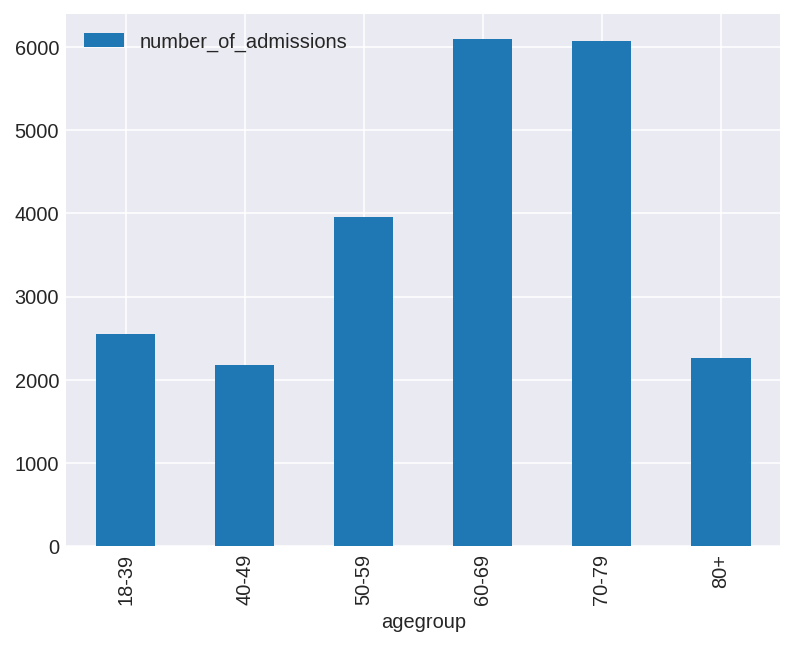

In [11]:
# modifies the pyplot back-end of Pandas to increase render resolution
import matplotlib.pyplot as plt
plt.style.use('seaborn-v0_8-darkgrid')
plt.rcParams["figure.dpi"] = 144

age_groups.plot(kind='bar', x='agegroup')

# Query AmsterdamUMCdb through pandas-gbq

The third option is to query the dataset using the Pandas `pandas-gbq` library. Especially when you are already familiar with the `pandas.read_sql` function, it's relatively straightforward to modify your existing code to be compatible with BigQuery. For more information, see [Pandas GBQ Documentation](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.read_gbq.html).


**Note**: The `use_bqstorage_api=True` statement enables the Google Cloud BigQuery Storage API that improves the performance of copying data from BiqQuery to pandas DataFrames in the Colab environment (~around 16 times). While the usage of the Storage Read API is being charged separately, Google currently offers a free tier of 300 TB per month. However, you may choose to remove the option from the command.

## Set the default query job configuration for pandas-gbq

In [12]:
import pandas as pd

config_gbq = {'query': 
          {'defaultDataset': {
              "datasetId": DATASET_ID, 
              "projectId": DATASET_PROJECT_ID
              },
           'Location': LOCATION}
           }

## Retrieve the medical specialty associated with each admission

<Axes: xlabel='specialty'>

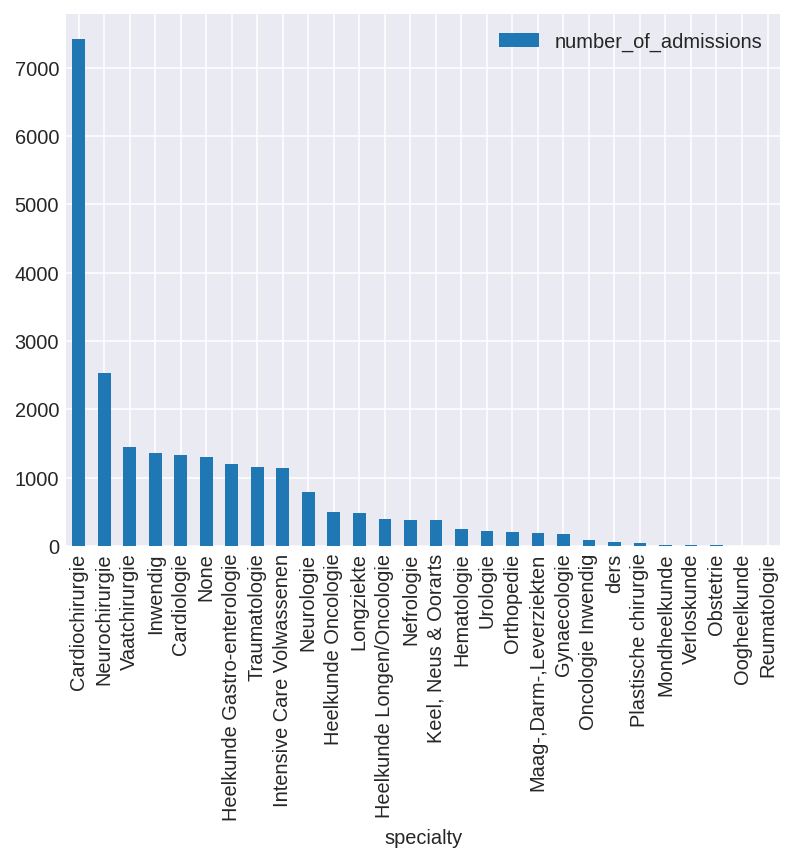

In [13]:
specialties = pd.read_gbq(
    '''
    SELECT specialty, COUNT(*) AS number_of_admissions
    FROM admissions
    GROUP BY specialty
    ORDER BY number_of_admissions DESC 
    '''
    , configuration=config_gbq, use_bqstorage_api=True)
specialties.plot(kind='bar', x='specialty')

# Getting the data you need
The `amsterdamumcdb` package provides the `get_dictionary()` function that returns a DataFrame containing all `item`s and `itemid`s in AmsterdamUMCdb. In combination with BigQuery DataTables, it's possible to quickly locate an item of interest. Since AmsterdamUMCdb originated from a real Dutch ICU database, the original item names are in Dutch. For common ICU parameters, English translations have been provided as `item_en` and `category_en`. In addition, as part of the `ICUnity` project in preparation for the [The Dutch ICU Data Warehouse](https://www.icudata.nl/index-en.html) a number of commonly used items have been mapped to [LOINC](https://decor.nictiz.nl/art-decor/loinc), [SNOMED CT](https://decor.nictiz.nl/art-decor/snomed-ct) or [ATC](https://www.whocc.no/atc_ddd_index/) with data in the `vocabulary_id`, `vocabulary_concept_code`, `vocabulary_concept_name` columns. The mapping process is still very much work in progress, but we are happy to take [pull requests](https://github.com/AmsterdamUMC/AmsterdamUMCdb/pulls) for the [dictionary.csv](https://github.com/AmsterdamUMC/AmsterdamUMCdb/blob/master/amsterdamumcdb/dictionary/dictionary.csv) file, if you have any additions.

## Install the AmsterdamUMCdb package

In [14]:
# get the amsterdamumcdb package from PyPI repository for use in Colab
!pip install amsterdamumcdb
import amsterdamumcdb as adb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 273.5/273.5 kB 8.8 MB/s eta 0:00:00


## Load the AmsterdamUMCdb dictionary. 
Use the **Filter** button to quickly browse through the dictionary.

In [15]:
dictionary = adb.get_dictionary()
dictionary

,itemid,item,item_en,vocabulary_id,vocabulary_concept_code,vocabulary_concept_name,abbreviation,categoryid,category,category_en,...,unitid,unit,ucum_code,low_normal_value,high_normal_value,expected_min_value,expected_max_value,table,count,count_validated
0,6637,Opname gewicht,NaN,NaN,NaN,NaN,GewichtOpname,466,Patientenbestandparameters,NaN,...,12.0,kg,kg,NaN,NaN,NaN,NaN,numericitems,2609,2609.0
1,6638,Huidig gewicht,NaN,NaN,NaN,NaN,GewichtX,328,OLGV-OUD,NaN,...,12.0,kg,kg,NaN,NaN,NaN,NaN,numericitems,2751,2751.0
2,6640,Hartfrequentie,heart rate,LOINC,76282-3,Heart rate.beat-to-beat by EKG,HF,320,HD-Hartritme,hemodynamics-heart rhythm,...,15.0,/min,/min,80,120,1.0,250.0,numericitems,37732398,2218626.0
3,6641,ABP systolisch,invasive systolic arterial pressure,LOINC,76215-3,Invasive Systolic blood pressure,ABPs,323,HD-Bloeddrukken,hemodynamics-blood pressures,...,173.0,mmHg,mm[Hg],80,160,40.0,250.0,numericitems,33343613,2109758.0
4,6642,ABP gemiddeld,invasive mean arterial pressure,LOINC,76214-6,Invasive Mean blood pressure,ABPm,323,HD-Bloeddrukken,hemodynamics-blood pressures,...,173.0,mmHg,mm[Hg],50,120,30.0,250.0,numericitems,33352770,2109165.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9026,21239,Actieve Mobilisatie Methode,NaN,NaN,NaN,NaN,Actieve Mobilisatie Methode,673,Overig,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,listitems,7,7.0
9027,21239,Actieve Mobilisatie Methode,NaN,NaN,NaN,NaN,Actieve Mobilisatie Methode,673,Overig,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,listitems,70,70.0
9028,21240,Nulmeting mobilisatie,NaN,NaN,NaN,NaN,Nulmeting mobilisatie,418,OPDR. Overig,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,procedureorderitems,924,NaN
9029,21241,Bupivacaine HCL,NaN,NaN,NaN,NaN,Bupivacaine HCL,268,Medicatie,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,drugitems,99,NaN


# Example: Lactate
Lactate, a laboratory measurement, can be found in the `numericitems` table. More information on `numericitems`:  [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/numericitems.ipynb)

Since this is a large table, it is highly recommended to only process the required columns.

# Selecting relevant features


## Get all lactate itemids

In [16]:
lactate_ids = dictionary[dictionary['item'].str.contains(r'la[ck]taat|lactate', regex=True, case=False)]
lactate_ids

,itemid,item,item_en,vocabulary_id,vocabulary_concept_code,vocabulary_concept_name,abbreviation,categoryid,category,category_en,...,unitid,unit,ucum_code,low_normal_value,high_normal_value,expected_min_value,expected_max_value,table,count,count_validated
161,6837,Laktaat,lactate,LOINC,32693-4,Lactate [Moles/volume] in Blood,Laktaat,371,LAB CHEMIE,NaN,...,97.0,mmol/l,mmol/L,"0,6","2,4",NaN,NaN,numericitems,1476,1476.0
427,7316,Ri-Lac (Ringers lactaat),Ringer's lactate solution,ATC,B05BB01,electrolytes,Ri-Lac(RingersLactaat),379,INFUUS-Crystalloïd,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,drugitems,36561,NaN
1548,9580,Laktaat Astrup,lactate (blood gas),LOINC,32693-4,Lactate [Moles/volume] in Blood,Laktaat Astrup,372,LAB ASTRUPS,NaN,...,97.0,mmol/l,mmol/L,NaN,NaN,NaN,NaN,numericitems,917,917.0
1549,9581,Laktaat afnemen,NaN,NaN,NaN,NaN,Laktaat afnemen,420,OPDR. Lab. afnemen,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,procedureorderitems,471,NaN
1745,10053,Lactaat (bloed),lactate,LOINC,32693-4,Lactate [Moles/volume] in Blood,Lactaat (bloed),490,LAB-Chem-bloed,NaN,...,97.0,mmol/l,mmol/L,0,"2,2",NaN,NaN,numericitems,182155,182155.0
1860,10304,Lactaat (overig),NaN,NaN,NaN,NaN,Lactaat (overig),479,LAB-Chem-diversen,NaN,...,97.0,mmol/l,mmol/L,NaN,NaN,NaN,NaN,numericitems,3,3.0
1890,10390,Lactaat (liquor),NaN,NaN,NaN,NaN,Lactaat (liquor),477,LAB-Chem-liquor,NaN,...,97.0,mmol/l,mmol/L,NaN,NaN,NaN,NaN,numericitems,1,1.0
5680,16953,SEPSIS_LACTAAT,NaN,NaN,NaN,NaN,SEPSIS_LACTAAT,703,Sepsis-screening,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,listitems,451,451.0
5681,16953,SEPSIS_LACTAAT,NaN,NaN,NaN,NaN,SEPSIS_LACTAAT,703,Sepsis-screening,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,listitems,17,17.0
5682,16953,SEPSIS_LACTAAT,NaN,NaN,NaN,NaN,SEPSIS_LACTAAT,703,Sepsis-screening,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,listitems,6,6.0


## Get lactate values for all patients

In [17]:
lactate = pd.read_gbq(
    '''
    SELECT admissionid, itemid, value, unitid, measuredat, registeredby
    FROM numericitems
    WHERE itemid IN (
      10053	--Lactaat (bloed)
      ,6837 --Laktaat
      ,9580 --Laktaat Astrup
    )
    '''
    , configuration=config_gbq, use_bqstorage_api=True)

#show number of records in the dataframe
print(f'Number of lactate values: {len(lactate)}')

#show first 1000 items
lactate.head(1000)

Number of lactate values: 184548


,admissionid,itemid,value,unitid,measuredat,registeredby
0,12290,6837,3.2,97,154920000,ICV_Medisch
1,12290,6837,4.4,97,223320000,ICV_IC-Verpleegkundig
2,12290,6837,4.4,97,3720000,ICV_IC-Verpleegkundig
3,12290,6837,3.3,97,136920000,ICV_IC-Verpleegkundig
4,12290,6837,3.4,97,176520000,ICV_IC-Verpleegkundig
...,...,...,...,...,...,...
995,15808,6837,1.6,97,108960000,ICV_IC-Verpleegkundig
996,15808,6837,4.1,97,4560000,ICV_IC-Verpleegkundig
997,15808,6837,1.3,97,62160000,ICV_IC-Verpleegkundig
998,15808,6837,1.7,97,83760000,ICV_Medisch


### Plot lactate values using default pandas histogram function

<Axes: >

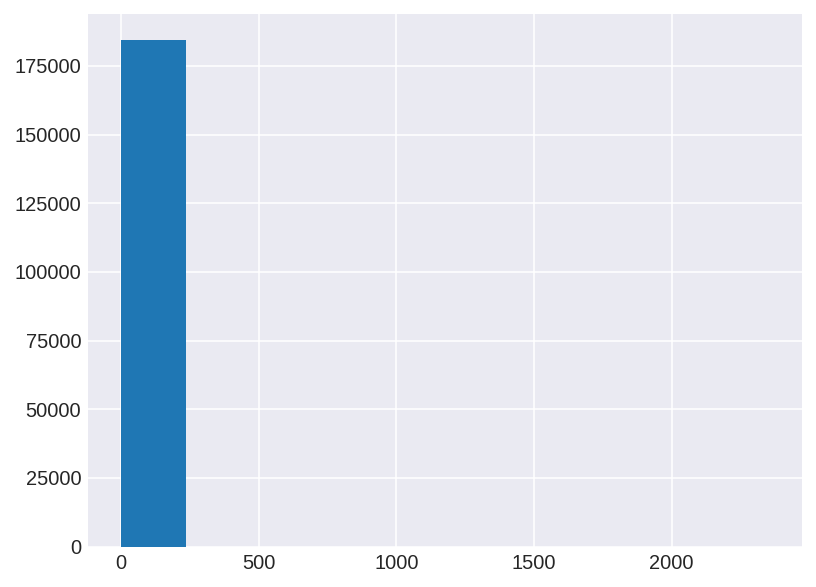

In [18]:
lactate['value'].hist()

### Plot lactate values using outlier aware histogram from AmsterdamUMCdb library

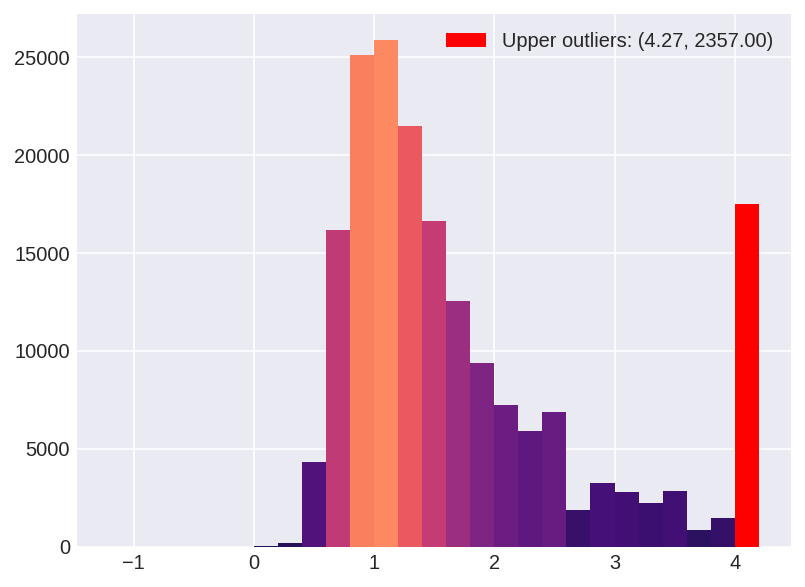

In [19]:
adb.outliers_histogram(data=lactate['value']).show()

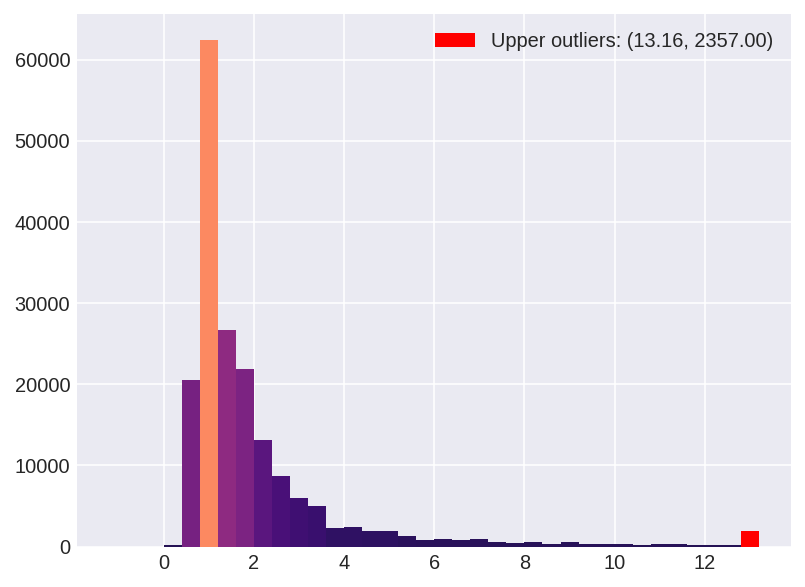

In [20]:
adb.outliers_histogram(data=lactate['value'], z_threshold=16).show()

In [21]:
lactate[lactate['value'] > 15].sort_values('value', ascending=False)

,admissionid,itemid,value,unitid,measuredat,registeredby
39263,6056,10053,2357.0,97,7605240000,ICV_IC-Verpleegkundig
1669,6893,9580,254.0,97,-15540000,ICV_IC-Verpleegkundig
39296,8060,10053,134.0,97,1766280000,ICV_IC-Verpleegkundig
15131,7447,10053,104.0,97,491640000,ICV_IC-Verpleegkundig
434,2397,6837,81.0,97,447300000,ICV_Medisch
...,...,...,...,...,...,...
40900,7573,10053,15.1,97,28200000,ICV_IC-Verpleegkundig
40901,15504,10053,15.1,97,5760000,Systeem
40902,7739,10053,15.1,97,59340000,ICV_Medisch
40903,7901,10053,15.1,97,-4320000,Systeem


This table demonstrates that the top 6 highest values are most likely data entry errors. They were also manually documented, instead of filed by the system (Dutch: 'Systeem')

## Example: Acute kidney injury: creatinine
Creatinine, a laboratory measurement that reflects kidney function, can be found in the `numericitems` table. More information on `numericitems`:  [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/numericitems.ipynb)

### Get all creatinine itemids

In [22]:
dictionary[dictionary['item'].str.contains(r'[ck]reat', regex=True, case=False)]

,itemid,item,item_en,vocabulary_id,vocabulary_concept_code,vocabulary_concept_name,abbreviation,categoryid,category,category_en,...,unitid,unit,ucum_code,low_normal_value,high_normal_value,expected_min_value,expected_max_value,table,count,count_validated
160,6836,Kreatinine,serum creatinine,LOINC,15045-8,Creatine [Moles/volume] in Serum or Plasma,Kreat,371,LAB CHEMIE,NaN,...,56.0,µmol,umol,30,100,NaN,NaN,numericitems,6481,6481.0
301,7108,Kreatinine klaring,NaN,NaN,NaN,NaN,Kreatinine klaring,275,LAB URINE,NaN,...,24.0,ml/min,mL/min,90,140,NaN,NaN,numericitems,2,2.0
302,7109,Kreatinine in urine,NaN,NaN,NaN,NaN,Kreatinine-Urine,275,LAB URINE,NaN,...,97.0,mmol/l,mmol/L,NaN,NaN,NaN,NaN,numericitems,47,47.0
1689,9941,Kreatinine (bloed),serum creatinine,LOINC,15045-8,Creatine [Moles/volume] in Serum or Plasma,Kreatinine (bloed),490,LAB-Chem-bloed,NaN,...,99.0,µmol/l,umol/L,60,110,NaN,NaN,numericitems,196186,196186.0
1690,9942,Kreatinine (Jaffé) (overig),NaN,NaN,NaN,NaN,Kreatinine (Jaffé) (overig),479,LAB-Chem-diversen,NaN,...,99.0,µmol/l,umol/L,NaN,NaN,NaN,NaN,numericitems,43,43.0
1841,10279,Kreatinine (urine),NaN,NaN,NaN,NaN,Kreatinine (urine),480,LAB-Chem-urine,NaN,...,97.0,mmol/l,mmol/L,NaN,NaN,NaN,NaN,numericitems,3340,3340.0
2575,11900,Kreat.klaring (urine),NaN,NaN,NaN,NaN,Kreat.klaring (urine),480,LAB-Chem-urine,NaN,...,24.0,ml/min,mL/min,NaN,NaN,NaN,NaN,numericitems,91,91.0
2576,11901,KREAT.KLAR (verz. urine),NaN,NaN,NaN,NaN,KREAT.KLAR-vur,481,LAB-Chem-verz. urine,NaN,...,24.0,ml/min,mL/min,NaN,NaN,NaN,NaN,numericitems,167,167.0
2845,12191,Kreatinine (Jaffé) (overig),NaN,NaN,NaN,NaN,Kreatinine (Jaffé) (overig),479,LAB-Chem-diversen,NaN,...,97.0,mmol/l,mmol/L,NaN,NaN,NaN,NaN,numericitems,16,16.0
2846,12192,Kreatinine (verz. urine),NaN,NaN,NaN,NaN,Kreatinine (verz. urine),481,LAB-Chem-verz. urine,NaN,...,97.0,mmol/l,mmol/L,NaN,NaN,NaN,NaN,numericitems,506,506.0


### Get creatinine values for all patients

In [25]:
creat = pd.read_gbq(
    '''
    SELECT 
        admissionid
        , itemid
        , value
        , unitid
        , measuredat
        , registeredby
    FROM numericitems
    WHERE itemid IN (
        6836  --Kreatinine
        , 9941  --Kreatinine (bloed)
        , 14216  --KREAT enzym. (bloed)
    )
    '''
    , configuration=config_gbq, use_bqstorage_api=True)

#show number of records in the dataframe
print(f'Number of creatinine values: {len(creat)}')

#show first 1000 items
creat.head(1000)

Number of creatinine values: 202700


,admissionid,itemid,value,unitid,measuredat,registeredby
0,11520,6836,88.0,56,11760000,ICV_IC-Verpleegkundig
1,16384,6836,122.0,56,780000,ICV_IC-Verpleegkundig
2,16384,6836,83.0,56,87180000,ICV_IC-Verpleegkundig
3,8705,6836,84.0,56,20160000,ICV_IC-Verpleegkundig
4,8705,6836,125.0,56,-1440000,ICV_IC-Verpleegkundig
...,...,...,...,...,...,...
995,10794,6836,108.0,56,2570160000,ICV_Medisch
996,10794,6836,142.0,56,1450560000,ICV_IC-Verpleegkundig
997,10794,6836,138.0,56,1540560000,ICV_Medisch
998,10794,6836,96.0,56,1014960000,ICV_Medisch


### Plot creatinine values using default pandas histogram function

<Axes: >

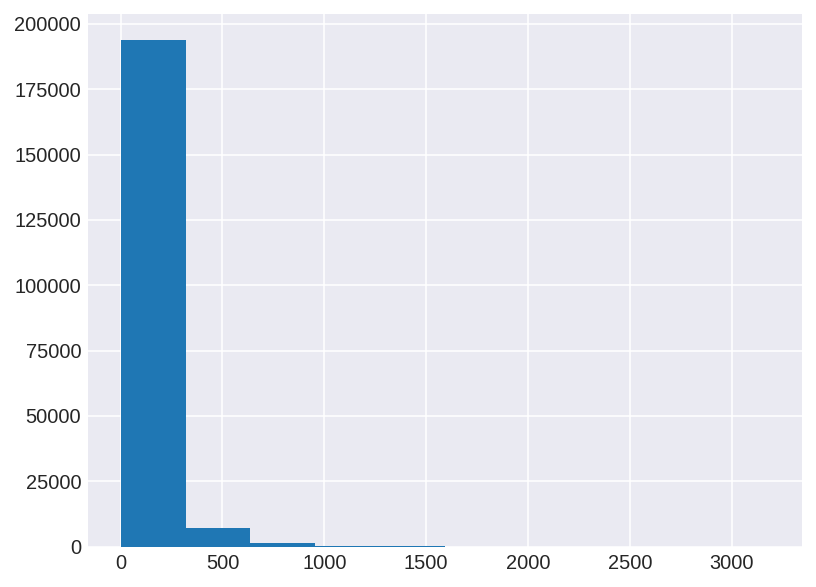

In [26]:
creat['value'].hist()

### Plot creatinine values using outlier aware histogram from AmsterdamUMCdb library

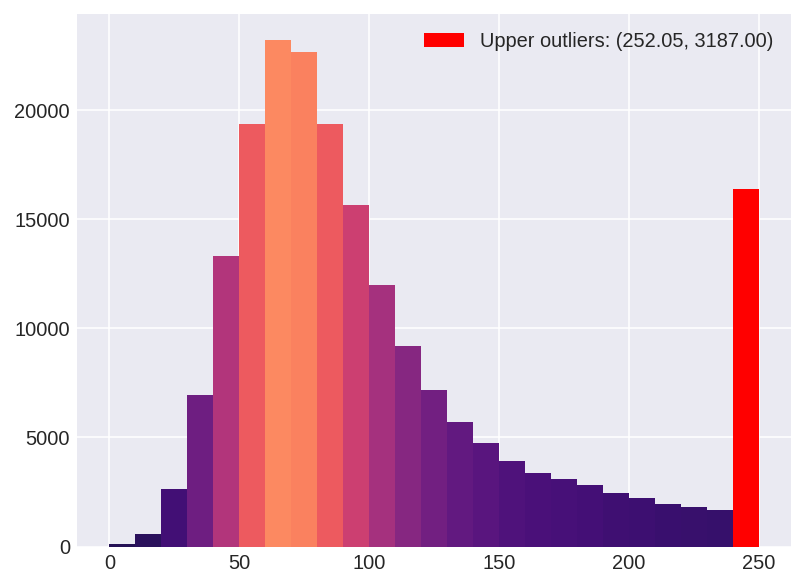

In [27]:
adb.outliers_histogram(data=creat['value']).show()

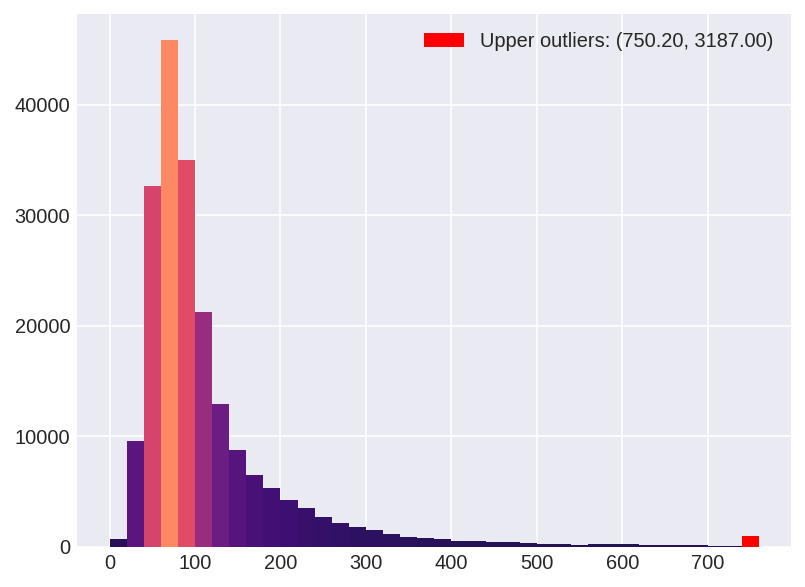

In [28]:
adb.outliers_histogram(data=creat['value'], z_threshold=16).show()

In [ ]:
creat[creat['value'] > 500].sort_values('value', ascending=False)

In [23]:
creat_patient = pd.read_gbq(
    '''
    SELECT 
        admissionid
        , itemid
        , value
        , unitid
        , measuredat
        , FORMAT('day %d: %02d:%02d'
            , CAST(FLOOR(measuredat/(1000*60*60*24)) AS INT) --days
            , CAST(FLOOR(MOD(measuredat, (1000*60*60*24))/(1000*60*60)) AS INT) --hours
            , CAST(FLOOR(MOD(measuredat, (1000*60*60))/(1000*60)) AS INT) --minutes
        ) AS days_hours_minutes
        , registeredby
    FROM numericitems
    WHERE itemid IN (
        6836  --Kreatinine
        , 9941  --Kreatinine (bloed)
        , 14216  --KREAT enzym. (bloed)
    )
        AND admissionid = 1583
    ORDER BY measuredat
    '''
    , configuration=config_gbq, use_bqstorage_api=True)
creat_patient

,admissionid,itemid,value,unitid,measuredat,days_hours_minutes,registeredby
0,1583,6836,207.0,56,13500000,day 0: 03:45,ICV_Medisch
1,1583,6836,226.0,56,24300000,day 0: 06:45,ICV_IC-Verpleegkundig
2,1583,6836,249.0,56,38700000,day 0: 10:45,ICV_IC-Verpleegkundig
3,1583,6836,291.0,56,71100000,day 0: 19:45,ICV_Medisch
4,1583,6836,335.0,56,92700000,day 1: 01:45,ICV_Medisch
5,1583,6836,345.0,56,114300000,day 1: 07:45,ICV_Medisch
6,1583,6836,313.0,56,135900000,day 1: 13:45,ICV_Physician assistant
7,1583,6836,291.0,56,157500000,day 1: 19:45,ICV_Physician assistant
8,1583,6836,284.0,56,179100000,day 2: 01:45,ICV_IC-Verpleegkundig
9,1583,6836,279.0,56,207900000,day 2: 09:45,ICV_Medisch


This table demonstrates that the highest value is most likely a data entry error: it was manually documented, instead of filed by the system (Dutch: 'Systeem')

## Example: Acute kidney injury: urine output
Urine output reflects kidney function as well, and can also be found in the `numericitems` table. Urine output is manually entered by nurses every 1-2 hours after emptying the urine collection bag.

### Get itemids related to urine output.
The category can be helpful when searching for the correct itemid.

In [ ]:
dictionary[dictionary['item'].str.contains(r'urine', regex=True, case=False)]

### Get urine output measurements for all patients

In [ ]:
urine_output = pd.read_gbq(
    '''
    SELECT 
        admissionid
        , itemid
        , value
        , unitid
        , measuredat
        , registeredby
    FROM numericitems
    WHERE itemid IN (
        8794  --UrineCAD
        , 8796  --UrineSupraPubis
        , 8798 --UrineSpontaan
        , 8800 --UrineIncontinentie
        , 8803 --UrineUP
        , 10743 --Nefrodrain li Uit
        , 10745 --Nefrodrain re Uit
        , 19921 --UrineSplint Li
        , 19922 --UrineSplint Re
    )
    '''
    , configuration=config_gbq, use_bqstorage_api=True)
#show number of records in the dataframe
print(f'Number of urine output values: {len(urine_output)}')

#show first 1000 items
urine_output.head(1000)

## Example: Mechanical ventilation: ventilation mode
There are different ways (modes) to mechanically ventilate patients. Patients that don't have any underlying breathing effort will be ventilated in a *control* mode. When patients recover (and sedative medication has been stopped or reduced) they will be ventilated in a *support* mode. Ventilation modes are documented as a categorical (list) value in the `listitems` table. The `listitems` table contains only validated data. Unvalidated device data (`registeredby IS NULL`) can be found in the `listitems_unvalidated` table. `listitems` have a `value` (text string) as wel as a `valueid`. Both are available from the dictionary.

More information on `listitems`: [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/listitems.ipynb)

### Get itemids related to ventilation mode

In [ ]:
dictionary[dictionary['item_en'].str.contains(r'vent.*mode', regex=True, case=False).fillna(False)]

In [ ]:
ventmode = pd.read_gbq(
    '''
    SELECT
        admissionid
        , itemid
        , item
        , valueid
        , value
        , measuredat
        --, registeredat
        --, registeredby
        --, updatedat
        --, updatedby
    FROM listitems
    WHERE itemid IN (
        6685  --Type Beademing Evita 4
        , 9534  --Type beademing Evita
        , 12290  --Ventilatie Mode (Set) Servo-i ventilator
    )
    '''
    , configuration=config_gbq, use_bqstorage_api=True)

#show number of records in the dataframe
print(f'Number of ventilation mode values: {len(ventmode)}')

#show first 1000 items
ventmode.head(1000)

## Example: Mechanical ventilation: tidal volume (measurement or setting)
Tidal volume, the amount of air passed into and out of the lungs during one ventilation cycle ('artificial breath'), is an important parameter in mechanical ventilation. Together with `respiratory rate`, tidal volume determines minute ventilation (`minute ventilation` = `tidal volume` * `respiratory rate`). [A landmark trial](https://doi.org/10.1056/NEJM200005043421801) has shown that ventilating patients with 6 ml/kg ideal body weight (IBW) instead of 12 ml/kg IBW leads to better outcomes for patients with [Acute Respiratory Distress Syndrome (ARDS)](https://en.wikipedia.org/wiki/Acute_respiratory_distress_syndrome). Depending on the ventilation mode, the tidal volume may be set or will be determined by other parameters (e.g. pressure).

### Get itemids related to tidal volume

In [ ]:
dictionary[dictionary['item'].str.contains(r'teug|tidal', regex=True, case=False)]

### Get *validated* tidal volume values for all patients


In [ ]:
tidal_volume = pd.read_gbq(
    '''
    SELECT
        admissionid
        , itemid
        , value
        , measuredat
        --, registeredat
        , registeredby
        --, updatedat
        --, updatedby
        --, islabresult
    FROM numericitems --only validated values
    WHERE itemid IN (
        8851  --Tidal Volume (Set)
        , 9646  --Tidal Volume (set)(2)
        , 12275  --Exp. tidal volume
        , 12277  --Insp. tidal volume
        , 12291	--Teugvolume (Set)
        , 12358 --Exp. tidal volume (2)
        , 12360  --Insp. tidal volume (2)
    )
    '''
    , configuration=config_gbq, use_bqstorage_api=True)

#show number of records in the dataframe
print(f'Number of tidal volume values: {len(tidal_volume)}')

#show first 1000 items
tidal_volume.head(1000)

In [ ]:
adb.outliers_histogram(data=tidal_volume['value']).show()

<a name="union-all"></a>
### Get *validated* and *unvalidated* tidal volume values for all patients
To get both validated and unvalidated tidal volume values, you will need to `UNION ALL` the `numericitems` and `numericitems_unvalidated` tables. Please be aware that adding the `numericitems_unvalidated` table to your dataset in this example, will increase the number of bytes processed from 3.4 to 30.4 GB, so make sure your approach really requires *unvalidated*  data.

In [ ]:
tidal_volume_all = pd.read_gbq(
    '''
    SELECT
        admissionid
        , itemid
        , value
        , measuredat
        --, registeredat
        , registeredby
        --, updatedat
        --, updatedby
        --, islabresult
    FROM (
      SELECT * FROM numericitems
      UNION ALL  
      SELECT * FROM numericitems_unvalidated
    )--all values
    WHERE itemid IN (
        8851  --Tidal Volume (Set)
        , 9646  --Tidal Volume (set)(2)
        , 12275  --Exp. tidal volume
        , 12277  --Insp. tidal volume
        , 12291	--Teugvolume (Set)
        , 12358 --Exp. tidal volume (2)
        , 12360  --Insp. tidal volume (2)
    )
    '''
    , configuration=config_gbq, use_bqstorage_api=True)

#show number of records in the dataframe
print(f'Number of tidal volume values (including unvalidated): {len(tidal_volume_all)}')

#show first 1000 items
tidal_volume_all.head(1000)

In [ ]:
adb.outliers_histogram(data=tidal_volume_all['value']).show()

## Conclusion
This finalizes our tutorial on accessing AmsterdamUMCdb using BigQuery. 

### What's next?
- Have a look at the AmsterdamUMCdb [wiki](https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki).
- Check more in depth examples for all tables, including those not mentioned in this tutorial:

Table | Wiki | Example code
:- | :--| -:
admissions|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/admissions | [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/admissions.ipynb) 
drugitems|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/drugitems|[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/drugitems.ipynb) 
freetextitems|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/freetextitems|[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/freetextitems.ipynb)
listitems|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/lisitems|[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/listitems.ipynb)
numericitems|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/numericitems|[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/numericitems.ipynb)
procedureorderitems|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/procedureorderitems|[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/procedureorderitems.ipynb)
processitems|https://github.com/AmsterdamUMC/AmsterdamUMCdb/wiki/processitems|[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/AmsterdamUMC/AmsterdamUMCdb/blob/master/tables/processitems.ipynb)

- Examine the [concepts](https://github.com/AmsterdamUMC/AmsterdamUMCdb/tree/master/concepts) for definitions related to diagnoses, life support systems, including mechanical ventilation and renal replacement therapy, and ICU scoring systems.
- And remember: medical data science is always a joint effort of disciplines, so start a discussion with your colleagues or team members early on how to approach your clinical problem.
